In [1]:
import os
import requests

from astropy.table import Table
from astropy.wcs import WCS
from astropy.visualization.wcsaxes import SphericalCircle
from astropy import units as u

import sys
sys.path.insert(1, '{}/desi/DESI_SGA/'.format(os.environ['HOME']))
try:
    from plot_funcs import plot_radec_DESI
except ModuleNotFoundError as e:
    print(e)
    
import psycopg2

import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
from matplotlib.backends.backend_pdf import PdfPages

from astropy.coordinates import SkyCoord, match_coordinates_sky

from glob import glob

from scipy.ndimage import gaussian_filter1d

from desispec.io import read_spectra
from desispec.spectra import stack as specstack
from desispec.coaddition import coadd_cameras

In [18]:
SGA = Table.read('SGA_distances.fits', format = 'fits')

In [3]:
inComa_sga_table = Table.read('cache/tf_targets_coma_sga.fits')
# inComa_sga_table

In [16]:
matched_SGA_ids = []
with open ('rosette_match_output_dist.txt', 'r') as file:
    lines = file.readlines()
    # print(lines)
    for line in lines:
        # print(line)
        if line == '\n':
            # print('h')
            continue
        elif line.split()[0] == 'TILE':
            # print('skipped')
            continue
        elif line.split()[0] == 'Match':
            matched_SGA_ids.append(int(line.split()[-1]))
    #     matched_SGA_ids.append(line.split()[-1])
        # break

In [24]:
SGA[SGA['SGA_ID'] == matched_SGA_ids[0]]

SGA_ID,SGA_GALAXY,GALAXY,PGC,RA_LEDA,DEC_LEDA,MORPHTYPE,PA_LEDA,D25_LEDA,BA_LEDA,Z_LEDA,SB_D25_LEDA,MAG_LEDA,BYHAND,REF,GROUP_ID,GROUP_NAME,GROUP_MULT,GROUP_PRIMARY,GROUP_RA,GROUP_DEC,GROUP_DIAMETER,BRICKNAME,RA,DEC,D26,D26_REF,PA,BA,RA_MOMENT,DEC_MOMENT,SMA_MOMENT,G_SMA50,R_SMA50,Z_SMA50,SMA_SB22,SMA_SB22.5,SMA_SB23,SMA_SB23.5,SMA_SB24,SMA_SB24.5,SMA_SB25,SMA_SB25.5,SMA_SB26,G_MAG_SB22,R_MAG_SB22,Z_MAG_SB22,G_MAG_SB22.5,R_MAG_SB22.5,Z_MAG_SB22.5,G_MAG_SB23,R_MAG_SB23,Z_MAG_SB23,G_MAG_SB23.5,R_MAG_SB23.5,Z_MAG_SB23.5,G_MAG_SB24,R_MAG_SB24,Z_MAG_SB24,G_MAG_SB24.5,R_MAG_SB24.5,Z_MAG_SB24.5,G_MAG_SB25,R_MAG_SB25,Z_MAG_SB25,G_MAG_SB25.5,R_MAG_SB25.5,Z_MAG_SB25.5,G_MAG_SB26,R_MAG_SB26,Z_MAG_SB26,SMA_SB22_ERR,SMA_SB22.5_ERR,SMA_SB23_ERR,SMA_SB23.5_ERR,SMA_SB24_ERR,SMA_SB24.5_ERR,SMA_SB25_ERR,SMA_SB25.5_ERR,SMA_SB26_ERR,G_MAG_SB22_ERR,R_MAG_SB22_ERR,Z_MAG_SB22_ERR,G_MAG_SB22.5_ERR,R_MAG_SB22.5_ERR,Z_MAG_SB22.5_ERR,G_MAG_SB23_ERR,R_MAG_SB23_ERR,Z_MAG_SB23_ERR,G_MAG_SB23.5_ERR,R_MAG_SB23.5_ERR,Z_MAG_SB23.5_ERR,G_MAG_SB24_ERR,R_MAG_SB24_ERR,Z_MAG_SB24_ERR,G_MAG_SB24.5_ERR,R_MAG_SB24.5_ERR,Z_MAG_SB24.5_ERR,G_MAG_SB25_ERR,R_MAG_SB25_ERR,Z_MAG_SB25_ERR,G_MAG_SB25.5_ERR,R_MAG_SB25.5_ERR,Z_MAG_SB25.5_ERR,G_MAG_SB26_ERR,R_MAG_SB26_ERR,Z_MAG_SB26_ERR,G_COG_PARAMS_MTOT,G_COG_PARAMS_M0,G_COG_PARAMS_ALPHA1,G_COG_PARAMS_ALPHA2,G_COG_PARAMS_CHI2,R_COG_PARAMS_MTOT,R_COG_PARAMS_M0,R_COG_PARAMS_ALPHA1,R_COG_PARAMS_ALPHA2,R_COG_PARAMS_CHI2,Z_COG_PARAMS_MTOT,Z_COG_PARAMS_M0,Z_COG_PARAMS_ALPHA1,Z_COG_PARAMS_ALPHA2,Z_COG_PARAMS_CHI2,ELLIPSEBIT,DM_Stellar,e_DM_lo_Stellar,e_DM_hi_Stellar,Stellar_Catalog,DM1_SN,e_DM1_SN,DM2_SN,e_DM2_SN,DM3_SN,e_DM3_SN,DM4_SN,e_DM4_SN,DM5_SN,e_DM5_SN,DM6_SN,e_DM6_SN,DM7_SN,e_DM7_SN,SN_Catalog
int64,bytes16,bytes29,int64,float64,float64,bytes21,float32,float32,float32,float32,float32,float32,bool,bytes13,int64,bytes35,int16,bool,float64,float64,float32,bytes8,float64,float64,float32,bytes4,float32,float32,float64,float64,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,int32,float64,float64,float64,bytes16,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,int64,float64,int64,bytes24
630029,SGA-2020 630029,PGC1209424,1209424,150.8062905,1.8953578000000002,Sc,131.97,0.49545017,0.712853,0.045520823,23.381481,16.278,False,LEDA-20181114,231847,PGC1209424,1,True,150.8062905,1.8953578000000002,0.49545017,1508p020,150.80634335939453,1.8953231518117883,0.5367224,SB26,132.53831,0.85148054,150.80640406988127,1.8953719875827462,14.435226,5.865074,5.4202905,5.0538025,5.8307796,7.52693,9.21022,10.703604,11.980811,13.0934515,14.08495,15.108985,16.101673,16.817,16.27681,15.905825,16.523462,16.016666,15.672356,16.337585,15.85488,15.526158,16.22607,15.756907,15.437314,16.161392,15.699485,15.384943,16.124775,15.667132,15.3554325,16.104507,15.648375,15.336931,16.091814,15.636435,15.32544,16.084387,15.628415,15.317555,0.015928278,0.023708086,0.023567623,0.03317677,0.030917259,0.034960903,0.038303662,0.062720306,0.09435116,0.010912042,0.015754262,0.019674687,0.008838185,0.012624177,0.015983919,0.0075758267,0.010916479,0.013945444,0.006946724,0.010049108,0.012942081,0.0065693334,0.009515543,0.012290936,0.006365552,0.009244531,0.011972402,0.006254949,0.00909132,0.011778067,0.0061862967,0.008995535,0.011662254,0.006147411,0.008932755,0.011585811,16

In [25]:
def get_cutout(targetid, ra, dec, size, verbose=False):
    """Grab and cache legacy survey cutouts.
    
    Parameters
    ----------
    targetid : int
        DESI target ID.
    ra : float
        Right ascension (degrees).
    dec : float
        Declination (degrees).
    verbose : bool
        Add some status messages if true.
        
    Returns
    -------
    img_name : str
        Name of JPG cutout file written after query.
    w : astropy.wcs.WCS
        World coordinate system for the image.
    """
    # Either load an existing image or download a cutout.
    img_name = 'cache/coma_{}.jpg'.format(targetid)
    
    if os.path.exists(img_name):
        if verbose:
            print('{} exists.'.format(img_name))
    else:
        img_url = 'https://www.legacysurvey.org/viewer/cutout.jpg?ra={}&dec={}&zoom=14&layer=ls-dr9&size={}&sga'.format(ra, dec, size)
        if verbose:
            print('Get {}'.format(img_url))
            
        with open(img_name, 'wb') as handle: 
            response = requests.get(img_url, stream=True) 
            if not response.ok: 
                print(response) 
            for block in response.iter_content(1024): 
                if not block: 
                    break 
                handle.write(block)
                
    # Set up the WCS.
    wcs_input_dict = {
        'CTYPE1': 'RA---TAN',
        'CUNIT1': 'deg',
        'CDELT1': -0.262/3600,
        'CRPIX1': size/2 + 0.5,
        'CRVAL1': ra,
        'NAXIS1': size,
        'CTYPE2': 'DEC--TAN',
        'CUNIT2': 'deg',
        'CDELT2': 0.262/3600,
        'CRPIX2': size/2 + 0.5,
        'CRVAL2': dec,
        'NAXIS2': size
    }
    w = WCS(wcs_input_dict)
    
    return img_name, w

In [26]:
def get_spectra_for_sga(targtab, sga_id, redux='everest/tiles/cumulative'):
    """Access spectra corresponding to all observations of a given SGA galaxy.
    
    Parameters
    ----------
    targtab : astropy.table.Table
        List of SGA + TFT observations.
    sga_id : int
        SGA ID of the central galaxy we're querying.
    redux : str
        The spectroscopic reduction we want to access.
    """
    prefix = '/'.join([os.environ['DESI_SPECTRO_REDUX'], redux])
    
    targets = targtab[targtab['SGA_ID'] == sga_id]
    targets.sort('TILEID')
    
    targetids = targets['TARGETID']
    tileids = targets['TILEID']
    
    coadd_spectra = None
    
    # Grab coadd files for this tile.
    for targetid, tileid in zip(targetids, tileids):
        tilefolder = sorted(glob('{}/{:d}/2*'.format(prefix, tileid)))[-1]
        tilefiles = sorted(glob('{}/coadd*.fits'.format(tilefolder)))
        
        # Grab the spectra corresponding to the TARGETID we queried.
        for tilefile in tilefiles:
            fmap = Table.read(tilefile, 'FIBERMAP')
            in1d = np.in1d(fmap['TARGETID'], targetid)
            
            # If we have something, read in the spectra and coadd across b,r,z cameras.
            if np.any(in1d):
                spectra = read_spectra(tilefile)[in1d]
                coadds = coadd_cameras(spectra)
                coadds.scores = None
                
                # Store the coadded spectra in a data structure.
                if coadd_spectra is None:
                    coadd_spectra = coadds
                else:
                    coadd_spectra = specstack([coadd_spectra, coadds])
                    
    return coadd_spectra

def plot_spectra(coadds):
    n = coadds.num_spectra()

    fig, axes = plt.subplots(n,1, figsize=(8,4*n), sharex=True, sharey=True, tight_layout=True)

    for i in range(n):
        wave = coadds.wave['brz']
        flux = coadds.flux['brz'][i]
        smoothed = gaussian_filter1d(flux, 7)

        ax = axes[i]
        ax.plot(wave, smoothed, label='TARGETID: {}'.format(coadds.fibermap['TARGETID'][i]))
        ax.set(ylabel=r'flux [$10^{-17}$ erg cm$^{-2}$ s$^{-1}$ $\AA^{-1}$]')
        if i+1 == n:
            ax.set(xlabel=r'$\lambda_\mathrm{obs}$ [$\AA$]')

        ax.legend(loc='upper right', fontsize=10)
    return axes

In [30]:
sga_ids = np.unique(matched_SGA_ids)
# coadds = get_spectra_for_sga(inComa_sga_table, sga_ids[2])
# sga_ids

In [31]:
np.array(sga_ids)

array([  49524,  135945,  294387,  464075,  474506,  497874,  630029,
        662902,  772284, 1065602, 1271764, 1351452, 1385252, 1413430,
       2000090])

In [34]:
# Change use_cached = False if we want to redo the query at some point.
use_cached = True

if os.path.exists('cache/tf_targets_everest.fits') and use_cached:
    tf_targets = Table.read('cache/tf_targets_everest.fits')
else:
    try:
        db = psycopg2.connect(host='decatdb.lbl.gov', database='desi', user='desi')
        cursor = db.cursor()
        
        query = """SELECT DISTINCT pr.pvtype, pr.sga_id, fd.targetid, fd.fiber_ra, fd.fiber_dec, fd.fiberstatus, fd.tileid, zd.target_ra, zd.target_dec, zd.z, zd.zerr, zd.spectype, zd.deltachi2, zd.zwarn
                   FROM everest.ztile_cumulative_fibermap fd
                   INNER JOIN
                       everest.ztile_cumulative_redshifts zd ON zd.targetid = fd.targetid
                   INNER JOIN pv.proposals pr ON (CAST(pr.ra*10000 AS INTEGER) = CAST(zd.target_ra*10000 AS INTEGER)) AND 
                                                 (CAST(pr.dec*10000 AS INTEGER) = CAST(zd.target_dec*10000 AS INTEGER))
                   WHERE (pr.pvtype LIKE 'TFT' or pr.pvtype LIKE 'EXT' or pr.pvtype LIKE 'SGA');"""
        
        cursor.execute(query)
        rows = cursor.fetchall()
        tf_targets = Table(list(map(list, zip(*rows))), 
                           names=['PVTYPE', 'SGA_ID', 'TARGETID', 'FIBER_RA', 'FIBER_DEC', 'FIBERSTATUS', 'TILEID', 
                                  'TARGET_RA', 'TARGET_DEC', 'Z', 'ZERR', 'SPECTYPE', 'DELTACHI2', 'ZWARN'])
        tf_targets.write('cache/tf_targets_everest.fits', overwrite=True)
        
    except (Exception, psycopg2.errors) as error:
        print(error)
    finally:
        if db is not None:
            db.close()
            
tf_targets[:5]

PVTYPE,SGA_ID,TARGETID,FIBER_RA,FIBER_DEC,FIBERSTATUS,TILEID,TARGET_RA,TARGET_DEC,Z,ZERR,SPECTYPE,DELTACHI2,ZWARN
bytes3,int64,int64,float64,float64,int64,int64,float64,float64,float64,float64,bytes6,float64,int64
EXT,17643,39633062056692288,0.0,0.0,0,80618,115.163713024568,39.2330431988692,0.0112272729370015,2.54691135614028e-06,GALAXY,199710.72255059,0
EXT,17643,39633062056692288,115.163671928495,39.2330481232594,0,80618,115.163713024568,39.2330431988692,0.0112272729370015,2.54691135614028e-06,GALAXY,199710.72255059,0
EXT,17643,39633062056692288,115.163676763292,39.2330716810911,0,80618,115.163713024568,39.2330431988692,0.0112272729370015,2.54691135614028e-06,GALAXY,199710.72255059,0
EXT,17643,39633062056692288,115.163687172584,39.2330595735952,0,80618,115.163713024568,39.2330431988692,0.0112272729370015,2.54691135614028e-06,GALAXY,199710.72255059,0
EXT,17643,39633062056692288,115.163687272099,39.2330517354585,0,80618,115.163713024568,39.2330431988692,0.0112272729370015,2.54691135614028e-06,GALAXY,199710.72255059,0


In [98]:
inComa_sga_table = tf_targets
dist_SGA_ids = np.unique(matched_SGA_ids)
dist_SGA_ids = np.delete(dist_SGA_IDS, [8, 10, 12])

In [100]:
dist_SGA_ids

array([  49524,  135945,  294387,  464075,  474506,  497874,  630029,
        662902, 1065602, 1351452, 1413430, 2000090])

cache/coma_39627793763402920.jpg exists.
cache/coma_39627746086750058.jpg exists.
cache/coma_39627769688098202.jpg exists.
cache/coma_39633136518171050.jpg exists.
cache/coma_39628443951827457.jpg exists.
only size-1 arrays can be converted to Python scalars
cache/coma_39627835576419368.jpg exists.
only size-1 arrays can be converted to Python scalars
only size-1 arrays can be converted to Python scalars
only size-1 arrays can be converted to Python scalars
only size-1 arrays can be converted to Python scalars
cache/coma_39627890865735486.jpg exists.


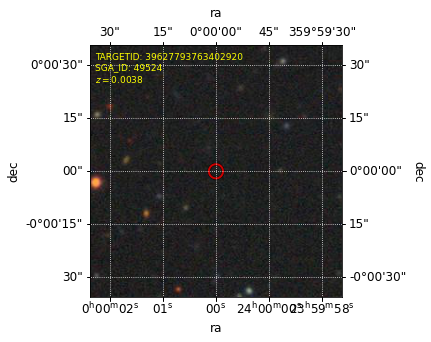

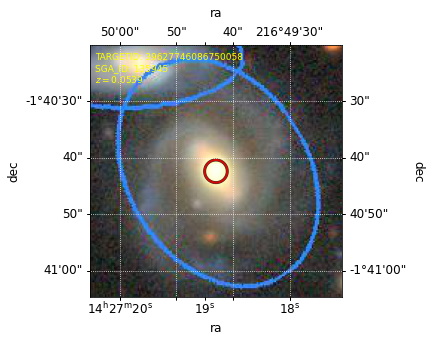

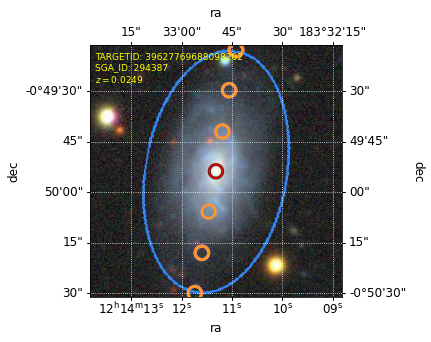

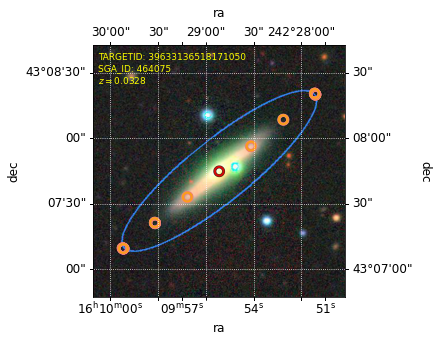

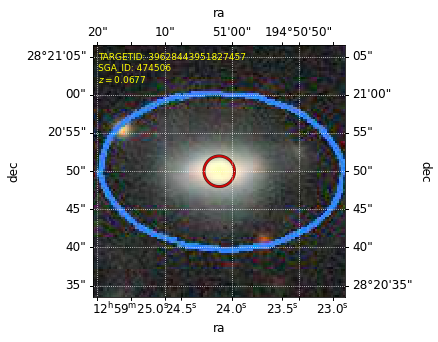

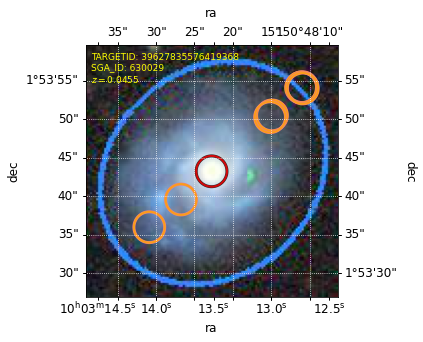

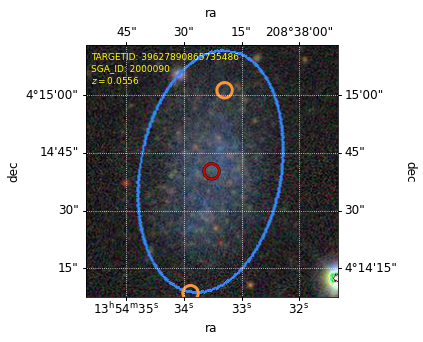

In [102]:
for sga_id in dist_SGA_ids:
    galaxy_list = inComa_sga_table[inComa_sga_table['SGA_ID'] == sga_id]
    
    # Total hack to find SGA target, because the PVTYPE can't be trusted.
    # Talk to an expert about actual SGA targets in DESI.
    is_sga_galaxy = (galaxy_list['TARGETID'] > 30000000000000000) & (galaxy_list['TARGETID'] < 40000000000000000)
    
    sga_galaxy = galaxy_list[is_sga_galaxy]
    tf_list = galaxy_list[~is_sga_galaxy]
    '''
    if np.sum(is_sga_galaxy) < 1:
        print('No center observation of galaxy {}'.format(sga_id))
        continue
    ''';
    if np.sum(is_sga_galaxy) > 1:
        # Multiple observations of the center - just take the first one in the table
#         print('{} observations of galaxy center for {}'.format(np.sum(is_sga_galaxy), sga_id))
        sga_galaxy = sga_galaxy[0]
        '''
        print('Too many records for {}'.format(sga_id))
        continue
        ''';
    # print(np.dtype(sga_galaxy['TARGETID']))
    try:
        targetid = int(sga_galaxy['TARGETID'])
    except TypeError as err:
        print(err)
        # print(sga_galaxy['TARGETID'])
        continue
    ra, dec, z = float(sga_galaxy['FIBER_RA']), float(sga_galaxy['FIBER_DEC']), float(sga_galaxy['Z'])
    
    # D26 in arcmin
    # print(SGA['D26'][SGA['SGA_ID'] == sga_id][0])
    d26 = float(SGA['D26'][SGA['SGA_ID'] == sga_id][0])
    
    
    center = SkyCoord(sga_galaxy['FIBER_RA'], sga_galaxy['FIBER_DEC'], unit='deg')
    offcenter = SkyCoord(tf_list['FIBER_RA'], tf_list['FIBER_DEC'], unit='deg')
    sep2d = offcenter.separation(center)
    #idx, sep2d, sep3d = match_coordinates_sky(offcenter, center)
    '''
    isoffcenter = sep2d.to('arcsec') > 1.5*u.arcsec
    if np.sum(isoffcenter) == 0:
        print('No observations off the galactic center for {}'.format(sga_id))
        continue
    ''';
    # Padd the image cutout of the galaxy.
    # Multiply by 60 (to arcsec), divide by 180 to get pixscale.
#     pixscale = 1.05*d26*60/180
    npix = np.minimum(int(1.025 * d26*60/0.262), 512)
    
    #print(targetid, sga_id, ra, dec)
#     img_file = get_cutout(targetid, ra, dec, size=npix, verbose=True)
    img_file, wcs = get_cutout(targetid, ra, dec, size=npix, verbose=True)
    img = mpl.image.imread(img_file)

    fig1 = plt.figure(figsize=(7,5))

    ax = fig1.add_subplot(111, projection=wcs)
    ax.imshow(np.flip(img, axis=0))
    ax.set(xlabel='ra', ylabel='dec')
    ax.text(int(0.02*npix), int(0.85*npix), 'TARGETID: {}\nSGA_ID: {}\n$z={{{:.4f}}}$'.format(targetid, sga_id, z), fontsize=9, color='yellow')
    overlay = ax.get_coords_overlay('icrs')
    overlay.grid(color='white', ls='dotted');

    # Add the location of the SDSS and DESI fibers.
    # SDSS fibers are 2" diameter, DESI is 107 um with 70 um/" plate scale.
    r1 = SphericalCircle((ra * u.deg, dec * u.deg), 2 * u.arcsec,
                         edgecolor='black', facecolor='none', alpha=0.8, lw=3,
                         transform=ax.get_transform('icrs'))
    r2 = SphericalCircle((ra * u.deg, dec * u.deg), 2 * u.arcsec,
                         edgecolor='red', facecolor='none', alpha=0.8, lw=2,
                         transform=ax.get_transform('icrs'))
    ax.add_patch(r1)
    ax.add_patch(r2)

    for tft in tf_list:
        ra, dec = float(tft['FIBER_RA']), float(tft['FIBER_DEC'])
        
        edgecolor2 = 'orange'
#         if tft['Z'] > 0.05:
#             edgecolor2 = 'orange'
#         else:
#             edgecolor2 = 'lime'
        
        # Add the location of the SDSS and DESI fibers.
        # SDSS fibers are 2" diameter, DESI is 107 um with 70 um/" plate scale.
        r1 = SphericalCircle((ra * u.deg, dec * u.deg), 2 * u.arcsec,
                             edgecolor='lightcoral', facecolor='none', alpha=1, lw=3,
                             transform=ax.get_transform('icrs'))
        r2 = SphericalCircle((ra * u.deg, dec * u.deg), 2 * u.arcsec,
                             edgecolor=edgecolor2, facecolor='none', alpha=0.8, lw=2,
                             transform=ax.get_transform('icrs'))
        ax.add_patch(r1)
        ax.add_patch(r2)
    
    fig1.subplots_adjust(top=0.85, right=0.85, bottom=0.15, left=0.15)
    
#     coadds = get_spectra_for_sga(inComa_sga_table, sga_id)
#     n = coadds.num_spectra()

#     fig2, axes = plt.subplots(n,1, figsize=(8,4*n), sharex=True, sharey=True, tight_layout=True)

#     for i in range(n):
#         wave = coadds.wave['brz']
#         flux = coadds.flux['brz'][i]
#         smoothed = gaussian_filter1d(flux, 7)

#         ax = axes[i]
#         ax.plot(wave, smoothed, label='TARGETID: {}'.format(coadds.fibermap['TARGETID'][i]))
#         ax.set(ylabel=r'flux [$10^{-17}$ erg cm$^{-2}$ s$^{-1}$ $\AA^{-1}$]')
#         if i+1 == n:
#             ax.set(xlabel=r'$\lambda_\mathrm{obs}$ [$\AA$]')

#         ax.legend(loc='upper right', fontsize=10)
    
    # figure = PdfPages('cache/DM_cutouts/dist_{}.pdf'.format(sga_id))
    # figure.savefig(fig1, dpi = 300)
    # figure.savefig(fig2, dpi = 120)
    # figure.close()
    fig1.savefig('cache/DM_cutouts/dist_{}.png'.format(sga_id), dpi=120, overwrite = True)
#     break
    
#     fig.clear()
#     plt.close(fig)

### Debugging

In [95]:
dist_SGA_IDS = np.unique(matched_SGA_ids)
np.delete(dist_SGA_IDS, [8, 10, 12])

array([  49524,  135945,  294387,  464075,  474506,  497874,  630029,
        662902, 1065602, 1351452, 1413430, 2000090])

In [94]:
np.unique(matched_SGA_ids)

array([  49524,  135945,  294387,  464075,  474506,  497874,  630029,
        662902,  772284, 1065602, 1271764, 1351452, 1385252, 1413430,
       2000090])

In [103]:
sga_id = 1065602
galaxy_list = tf_targets[tf_targets['SGA_ID'] == sga_id]
galaxy_list

PVTYPE,SGA_ID,TARGETID,FIBER_RA,FIBER_DEC,FIBERSTATUS,TILEID,TARGET_RA,TARGET_DEC,Z,ZERR,SPECTYPE,DELTACHI2,ZWARN
bytes3,int64,int64,float64,float64,int64,int64,float64,float64,float64,float64,bytes6,float64,int64
EXT,1065602,1070083786932227,180.069081047282,-1.13063672730524,0,47,180.069093043901,-1.13063657023067,0.314211103548395,8.99687419999469e-05,GALAXY,11.9885362843052,0
EXT,1065602,1070083786932227,180.069081047282,-1.13063672730524,0,47,180.069093043901,-1.13063657023067,0.509733258896181,0.000183820475708688,GALAXY,0.300686610862613,4
EXT,1065602,1070083786932227,180.069113462219,-1.13060904770843,0,49,180.069093043901,-1.13063657023067,0.314211103548395,8.99687419999469e-05,GALAXY,11.9885362843052,0
EXT,1065602,1070083786932227,180.069113462219,-1.13060904770843,0,49,180.069093043901,-1.13063657023067,0.509733258896181,0.000183820475708688,GALAXY,0.300686610862613,4
EXT,1065602,1070089826729999,180.078776677654,-1.12058300310019,0,48,180.078788337759,-1.1205943454118,0.746094367492531,7.62694352453005e-05,GALAXY,3.1687423735857,4
EXT,1065602,1070089826730003,180.12786741484,-1.06976602277954,0,48,180.127851393537,-1.06977411567805,1.37913503548604,9.57425741052054e-05,GALAXY,0.649914756417274,4
EXT,1065602,1083277926465539,180.069041936376,-1.1306144675157,0,37,180.069093043901,-1.13063657023067,0.460913056406388,7.78243957788573e-05,GALAXY,13.5423807073385,0
EXT,1065602,1083277926465539,180.069041936376,-1.1306144675157,0,37,180.069093043901,-1.13063657023067,0.616975075653136,8.75573421552771e-05,GALAXY,0.749571323394775,4
EXT,1065602,1083277926465539,180.069041936376,-1.1306144675157,0,37,180.069093043901,-1.13063657023067,1.37936840032888,7.50398804546083e-05,GALAXY,5.35867356136441,4


In [104]:
is_sga_galaxy = (galaxy_list['TARGETID'] > 30000000000000000) & (galaxy_list['TARGETID'] < 40000000000000000)
sga_galaxy = galaxy_list[is_sga_galaxy]
tf_list = galaxy_list[~is_sga_galaxy]

In [109]:
is_sga_galaxy

array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False,

In [105]:
sga_id = 1065602
galaxy_list = inComa_sga_table[inComa_sga_table['SGA_ID'] == sga_id]
    
# Total hack to find SGA target, because the PVTYPE can't be trusted.
# Talk to an expert about actual SGA targets in DESI.
is_sga_galaxy = (galaxy_list['TARGETID'] > 30000000000000000) & (galaxy_list['TARGETID'] < 40000000000000000)

sga_galaxy = galaxy_list[is_sga_galaxy]
tf_list = galaxy_list[~is_sga_galaxy]
'''
if np.sum(is_sga_galaxy) < 1:
    print('No center observation of galaxy {}'.format(sga_id))
    continue
''';
if np.sum(is_sga_galaxy) > 1:
    # Multiple observations of the center - just take the first one in the table
#         print('{} observations of galaxy center for {}'.format(np.sum(is_sga_galaxy), sga_id))
    sga_galaxy = sga_galaxy[0]
    '''
    print('Too many records for {}'.format(sga_id))
    continue
    ''';
# print(np.dtype(sga_galaxy['TARGETID']))
try:
    targetid = int(sga_galaxy['TARGETID'])
except TypeError as err:
    print(err)
    # print(sga_galaxy['TARGETID'])
    pass
ra, dec, z = float(sga_galaxy['FIBER_RA']), float(sga_galaxy['FIBER_DEC']), float(sga_galaxy['Z'])

# D26 in arcmin
# print(SGA['D26'][SGA['SGA_ID'] == sga_id][0])
d26 = float(SGA['D26'][SGA['SGA_ID'] == sga_id][0])


center = SkyCoord(sga_galaxy['FIBER_RA'], sga_galaxy['FIBER_DEC'], unit='deg')
offcenter = SkyCoord(tf_list['FIBER_RA'], tf_list['FIBER_DEC'], unit='deg')
sep2d = offcenter.separation(center)
#idx, sep2d, sep3d = match_coordinates_sky(offcenter, center)
'''
isoffcenter = sep2d.to('arcsec') > 1.5*u.arcsec
if np.sum(isoffcenter) == 0:
    print('No observations off the galactic center for {}'.format(sga_id))
    continue
''';
# Padd the image cutout of the galaxy.
# Multiply by 60 (to arcsec), divide by 180 to get pixscale.
#     pixscale = 1.05*d26*60/180
npix = np.minimum(int(1.025 * d26*60/0.262), 512)

#print(targetid, sga_id, ra, dec)
#     img_file = get_cutout(targetid, ra, dec, size=npix, verbose=True)
img_file, wcs = get_cutout(targetid, ra, dec, size=npix, verbose=True)
img = mpl.image.imread(img_file)

fig1 = plt.figure(figsize=(7,5))

ax = fig1.add_subplot(111, projection=wcs)
ax.imshow(np.flip(img, axis=0))
ax.set(xlabel='ra', ylabel='dec')
ax.text(int(0.02*npix), int(0.85*npix), 'TARGETID: {}\nSGA_ID: {}\n$z={{{:.4f}}}$'.format(targetid, sga_id, z), fontsize=9, color='yellow')
overlay = ax.get_coords_overlay('icrs')
overlay.grid(color='white', ls='dotted');

# Add the location of the SDSS and DESI fibers.
# SDSS fibers are 2" diameter, DESI is 107 um with 70 um/" plate scale.
r1 = SphericalCircle((ra * u.deg, dec * u.deg), 2 * u.arcsec,
                     edgecolor='black', facecolor='none', alpha=0.8, lw=3,
                     transform=ax.get_transform('icrs'))
r2 = SphericalCircle((ra * u.deg, dec * u.deg), 2 * u.arcsec,
                     edgecolor='red', facecolor='none', alpha=0.8, lw=2,
                     transform=ax.get_transform('icrs'))
ax.add_patch(r1)
ax.add_patch(r2)

for tft in tf_list:
    ra, dec = float(tft['FIBER_RA']), float(tft['FIBER_DEC'])

    edgecolor2 = 'orange'

    # Add the location of the SDSS and DESI fibers.
    # SDSS fibers are 2" diameter, DESI is 107 um with 70 um/" plate scale.
    r1 = SphericalCircle((ra * u.deg, dec * u.deg), 2 * u.arcsec,
                         edgecolor='lightcoral', facecolor='none', alpha=1, lw=3,
                         transform=ax.get_transform('icrs'))
    r2 = SphericalCircle((ra * u.deg, dec * u.deg), 2 * u.arcsec,
                         edgecolor=edgecolor2, facecolor='none', alpha=0.8, lw=2,
                         transform=ax.get_transform('icrs'))
    ax.add_patch(r1)
    ax.add_patch(r2)

fig1.subplots_adjust(top=0.85, right=0.85, bottom=0.15, left=0.15)
fig1.savefig('cache/DM_cutouts/dist_{}.png'.format(sga_id), dpi=120, overwrite = True)
#     break

only size-1 arrays can be converted to Python scalars


TypeError: only size-1 arrays can be converted to Python scalars

In [40]:
np.unique(matched_SGA_ids)

array([  49524,  135945,  294387,  464075,  474506,  497874,  630029,
        662902,  772284, 1065602, 1271764, 1351452, 1385252, 1413430,
       2000090])

cache/coma_39628427912806609.jpg exists.
INFO:spectra.py:282:read_spectra: iotime 0.668 sec to read coadd-0-114-thru20210416.fits at 2021-10-15T08:41:17.635356
INFO:spectra.py:282:read_spectra: iotime 0.460 sec to read coadd-0-114-thru20210416.fits at 2021-10-15T08:41:20.536492
INFO:spectra.py:282:read_spectra: iotime 0.637 sec to read coadd-9-118-thru20210503.fits at 2021-10-15T08:41:24.168889
INFO:spectra.py:282:read_spectra: iotime 0.664 sec to read coadd-0-120-thru20210407.fits at 2021-10-15T08:41:25.492780
INFO:spectra.py:282:read_spectra: iotime 0.475 sec to read coadd-0-120-thru20210407.fits at 2021-10-15T08:41:27.830481
INFO:spectra.py:282:read_spectra: iotime 0.717 sec to read coadd-9-127-thru20210506.fits at 2021-10-15T08:41:31.947027
cache/coma_39628427912810105.jpg exists.
INFO:spectra.py:282:read_spectra: iotime 0.654 sec to read coadd-9-119-thru20210504.fits at 2021-10-15T08:41:37.293282
INFO:spectra.py:282:read_spectra: iotime 0.623 sec to read coadd-9-123-thru20210418.f

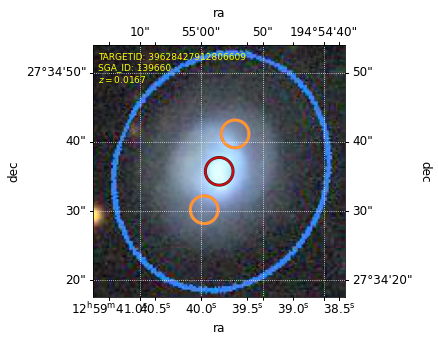

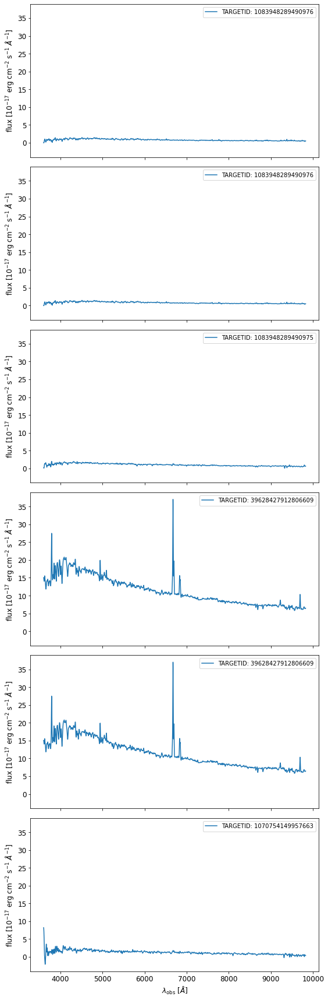

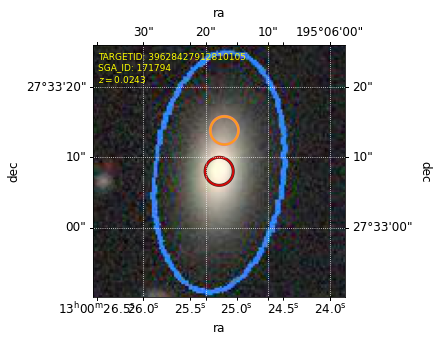

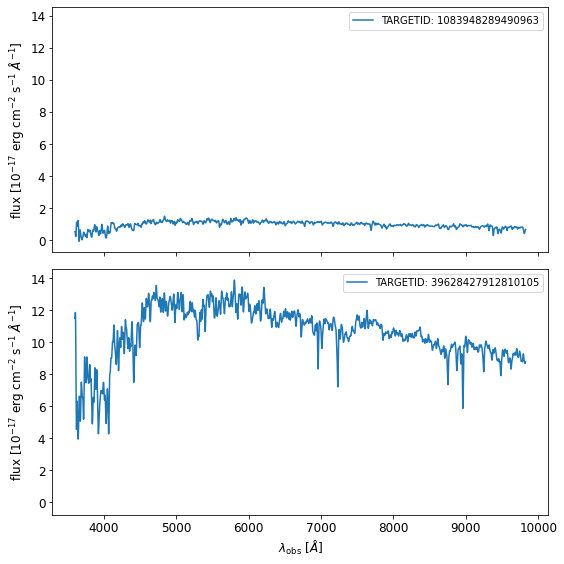

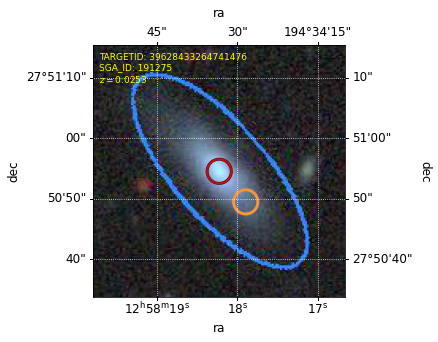

...

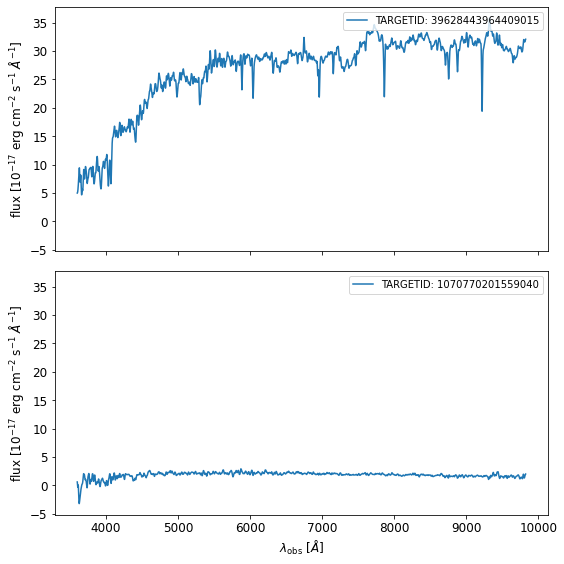

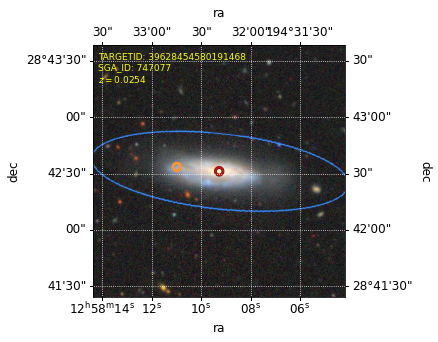

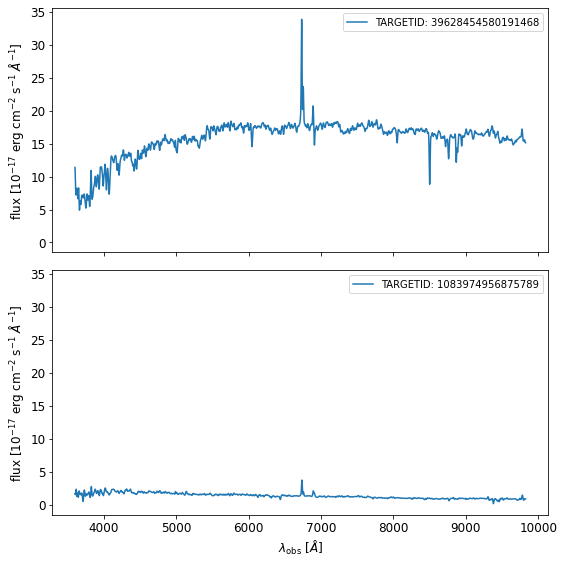

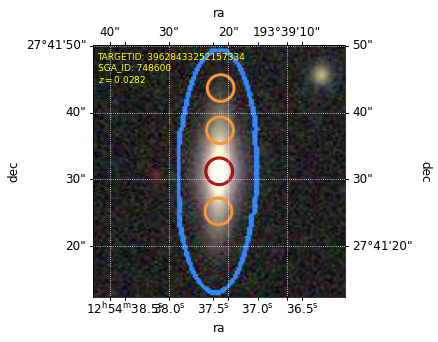

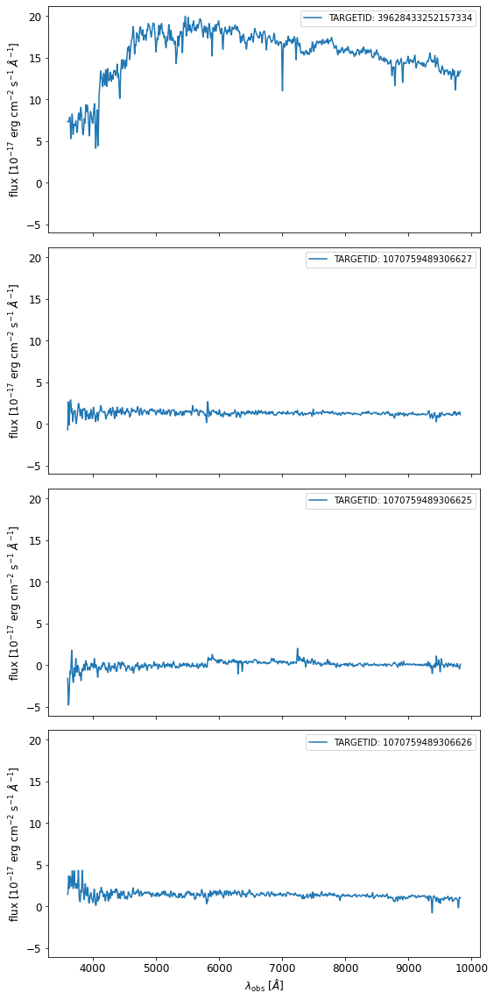

In [40]:
for sga_id in sga_ids[11:53]:
    galaxy_list = inComa_sga_table[inComa_sga_table['SGA_ID'] == sga_id]
    
    # Total hack to find SGA target, because the PVTYPE can't be trusted.
    # Talk to an expert about actual SGA targets in DESI.
    is_sga_galaxy = (galaxy_list['TARGETID'] > 30000000000000000) & (galaxy_list['TARGETID'] < 40000000000000000)
    
    sga_galaxy = galaxy_list[is_sga_galaxy]
    tf_list = galaxy_list[~is_sga_galaxy]
    '''
    if np.sum(is_sga_galaxy) < 1:
        print('No center observation of galaxy {}'.format(sga_id))
        continue
    ''';
    if np.sum(is_sga_galaxy) > 1:
        # Multiple observations of the center - just take the first one in the table
#         print('{} observations of galaxy center for {}'.format(np.sum(is_sga_galaxy), sga_id))
        sga_galaxy = sga_galaxy[0]
        '''
        print('Too many records for {}'.format(sga_id))
        continue
        ''';
        
    targetid = int(sga_galaxy['TARGETID'])
    ra, dec, z = float(sga_galaxy['FIBER_RA']), float(sga_galaxy['FIBER_DEC']), float(sga_galaxy['Z'])
    
    # D26 in arcmin
    d26 = float(SGA['D26'][SGA['SGA_ID'] == sga_id])
    
    center = SkyCoord(sga_galaxy['FIBER_RA'], sga_galaxy['FIBER_DEC'], unit='deg')
    offcenter = SkyCoord(tf_list['FIBER_RA'], tf_list['FIBER_DEC'], unit='deg')
    sep2d = offcenter.separation(center)
    #idx, sep2d, sep3d = match_coordinates_sky(offcenter, center)
    '''
    isoffcenter = sep2d.to('arcsec') > 1.5*u.arcsec
    if np.sum(isoffcenter) == 0:
        print('No observations off the galactic center for {}'.format(sga_id))
        continue
    ''';
    # Padd the image cutout of the galaxy.
    # Multiply by 60 (to arcsec), divide by 180 to get pixscale.
#     pixscale = 1.05*d26*60/180
    npix = np.minimum(int(1.025 * d26*60/0.262), 512)
    
    #print(targetid, sga_id, ra, dec)
#     img_file = get_cutout(targetid, ra, dec, size=npix, verbose=True)
    img_file, wcs = get_cutout(targetid, ra, dec, size=npix, verbose=True)
    img = mpl.image.imread(img_file)

    fig1 = plt.figure(figsize=(7,5))

    ax = fig1.add_subplot(111, projection=wcs)
    ax.imshow(np.flip(img, axis=0))
    ax.set(xlabel='ra', ylabel='dec')
    ax.text(int(0.02*npix), int(0.85*npix), 'TARGETID: {}\nSGA_ID: {}\n$z={{{:.4f}}}$'.format(targetid, sga_id, z), fontsize=9, color='yellow')
    overlay = ax.get_coords_overlay('icrs')
    overlay.grid(color='white', ls='dotted');

    # Add the location of the SDSS and DESI fibers.
    # SDSS fibers are 2" diameter, DESI is 107 um with 70 um/" plate scale.
    r1 = SphericalCircle((ra * u.deg, dec * u.deg), 2 * u.arcsec,
                         edgecolor='black', facecolor='none', alpha=0.8, lw=3,
                         transform=ax.get_transform('icrs'))
    r2 = SphericalCircle((ra * u.deg, dec * u.deg), 2 * u.arcsec,
                         edgecolor='red', facecolor='none', alpha=0.8, lw=2,
                         transform=ax.get_transform('icrs'))
    ax.add_patch(r1)
    ax.add_patch(r2)

    for tft in tf_list:
        ra, dec = float(tft['FIBER_RA']), float(tft['FIBER_DEC'])
        
        edgecolor2 = 'orange'
#         if tft['Z'] > 0.05:
#             edgecolor2 = 'orange'
#         else:
#             edgecolor2 = 'lime'
        
        # Add the location of the SDSS and DESI fibers.
        # SDSS fibers are 2" diameter, DESI is 107 um with 70 um/" plate scale.
        r1 = SphericalCircle((ra * u.deg, dec * u.deg), 2 * u.arcsec,
                             edgecolor='lightcoral', facecolor='none', alpha=1, lw=3,
                             transform=ax.get_transform('icrs'))
        r2 = SphericalCircle((ra * u.deg, dec * u.deg), 2 * u.arcsec,
                             edgecolor=edgecolor2, facecolor='none', alpha=0.8, lw=2,
                             transform=ax.get_transform('icrs'))
        ax.add_patch(r1)
        ax.add_patch(r2)
    
    fig1.subplots_adjust(top=0.85, right=0.85, bottom=0.15, left=0.15)
    
    coadds = get_spectra_for_sga(inComa_sga_table, sga_id)
    n = coadds.num_spectra()

    fig2, axes = plt.subplots(n,1, figsize=(8,4*n), sharex=True, sharey=True, tight_layout=True)

    for i in range(n):
        wave = coadds.wave['brz']
        flux = coadds.flux['brz'][i]
        smoothed = gaussian_filter1d(flux, 7)

        ax = axes[i]
        ax.plot(wave, smoothed, label='TARGETID: {}'.format(coadds.fibermap['TARGETID'][i]))
        ax.set(ylabel=r'flux [$10^{-17}$ erg cm$^{-2}$ s$^{-1}$ $\AA^{-1}$]')
        if i+1 == n:
            ax.set(xlabel=r'$\lambda_\mathrm{obs}$ [$\AA$]')

        ax.legend(loc='upper right', fontsize=10)
    
    figure = PdfPages('cache/coma_tf_cutouts/coma_tf_{}.pdf'.format(sga_id))
    figure.savefig(fig1, dpi = 300)
    figure.savefig(fig2, dpi = 120)
    figure.close()

In [15]:
sga_id

900049

Get https://www.legacysurvey.org/viewer/cutout.jpg?ra=195.140377066853&dec=27.6377321604914&zoom=14&layer=ls-dr9&size=232&sga
INFO:spectra.py:282:read_spectra: iotime 0.480 sec to read coadd-9-115-thru20210417.fits at 2021-10-13T08:50:04.766744
INFO:spectra.py:282:read_spectra: iotime 0.452 sec to read coadd-9-117-thru20210430.fits at 2021-10-13T08:50:06.911708
INFO:spectra.py:282:read_spectra: iotime 0.451 sec to read coadd-9-118-thru20210503.fits at 2021-10-13T08:50:09.063585
INFO:spectra.py:282:read_spectra: iotime 0.644 sec to read coadd-9-120-thru20210407.fits at 2021-10-13T08:50:12.714491
INFO:spectra.py:282:read_spectra: iotime 0.479 sec to read coadd-9-120-thru20210407.fits at 2021-10-13T08:50:14.363549
INFO:spectra.py:282:read_spectra: iotime 0.657 sec to read coadd-9-125-thru20210504.fits at 2021-10-13T08:50:16.810797
INFO:spectra.py:282:read_spectra: iotime 0.506 sec to read coadd-9-125-thru20210504.fits at 2021-10-13T08:50:18.768016
INFO:spectra.py:282:read_spectra: iotime 

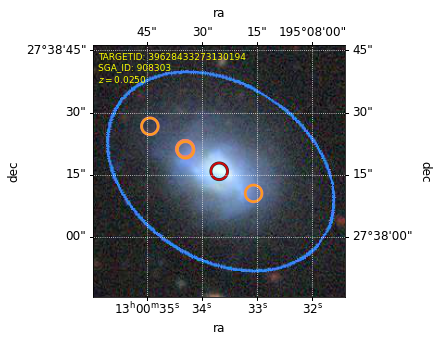

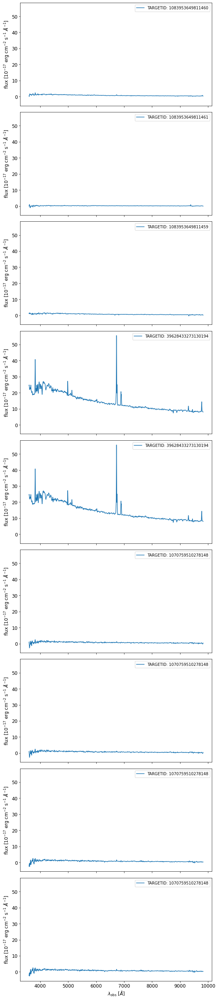

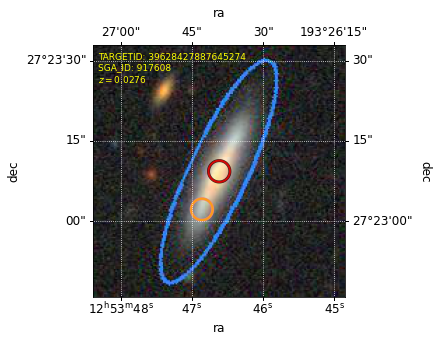

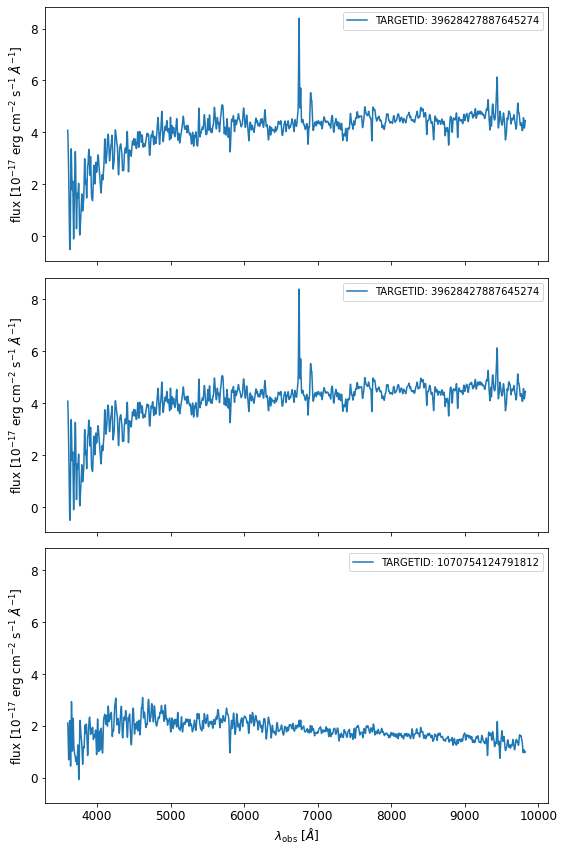

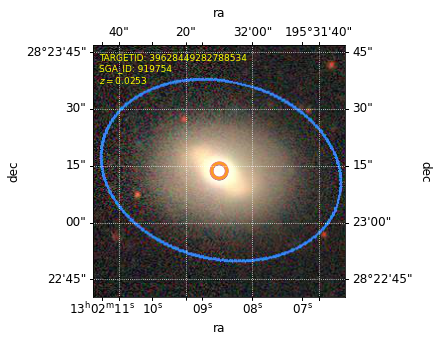

...

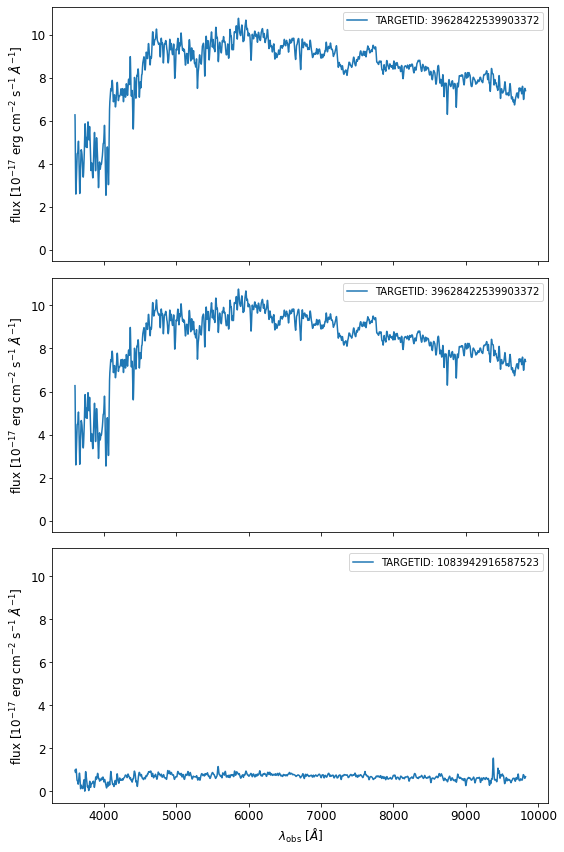

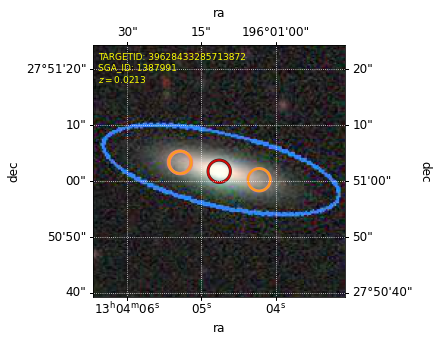

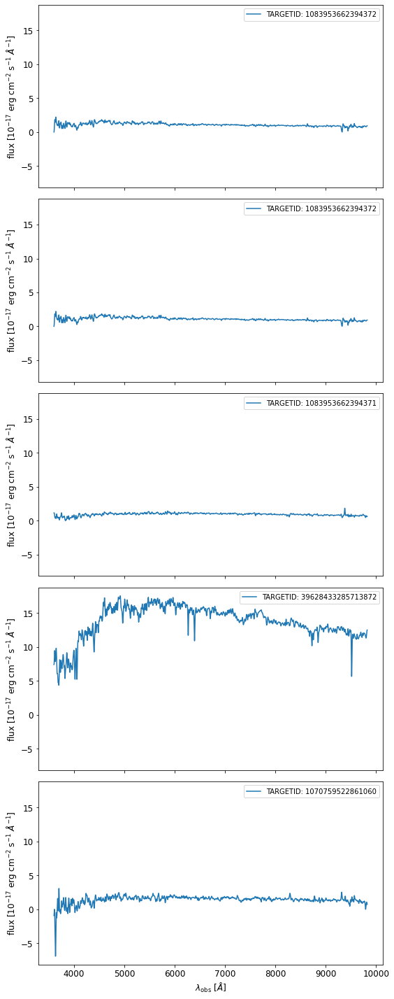

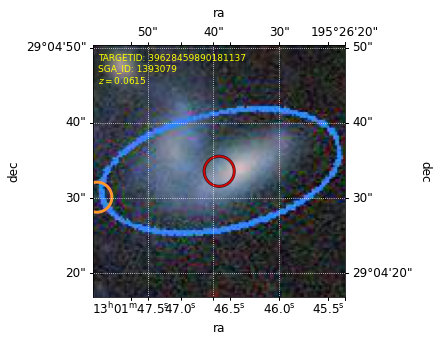

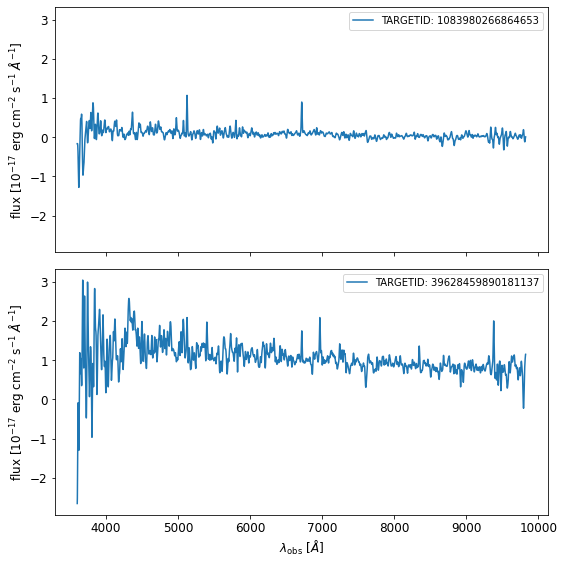

In [22]:
for sga_id in sga_ids[65:]:
    galaxy_list = inComa_sga_table[inComa_sga_table['SGA_ID'] == sga_id]

    # Total hack to find SGA target, because the PVTYPE can't be trusted.
    # Talk to an expert about actual SGA targets in DESI.
    is_sga_galaxy = (galaxy_list['TARGETID'] > 30000000000000000) & (galaxy_list['TARGETID'] < 40000000000000000)

    sga_galaxy = galaxy_list[is_sga_galaxy]
    tf_list = galaxy_list[~is_sga_galaxy]
    '''
    if np.sum(is_sga_galaxy) < 1:
        print('No center observation of galaxy {}'.format(sga_id))
        continue
    ''';
    if np.sum(is_sga_galaxy) > 1:
        # Multiple observations of the center - just take the first one in the table
    #         print('{} observations of galaxy center for {}'.format(np.sum(is_sga_galaxy), sga_id))
        sga_galaxy = sga_galaxy[0]
        '''
        print('Too many records for {}'.format(sga_id))
        continue
        ''';

    targetid = int(sga_galaxy['TARGETID'])
    ra, dec, z = float(sga_galaxy['FIBER_RA']), float(sga_galaxy['FIBER_DEC']), float(sga_galaxy['Z'])

    # D26 in arcmin
    d26 = float(SGA['D26'][SGA['SGA_ID'] == sga_id])

    center = SkyCoord(sga_galaxy['FIBER_RA'], sga_galaxy['FIBER_DEC'], unit='deg')
    offcenter = SkyCoord(tf_list['FIBER_RA'], tf_list['FIBER_DEC'], unit='deg')
    sep2d = offcenter.separation(center)
    #idx, sep2d, sep3d = match_coordinates_sky(offcenter, center)
    '''
    isoffcenter = sep2d.to('arcsec') > 1.5*u.arcsec
    if np.sum(isoffcenter) == 0:
        print('No observations off the galactic center for {}'.format(sga_id))
        continue
    ''';
    # Padd the image cutout of the galaxy.
    # Multiply by 60 (to arcsec), divide by 180 to get pixscale.
    #     pixscale = 1.05*d26*60/180
    npix = np.minimum(int(1.025 * d26*60/0.262), 512)

    #print(targetid, sga_id, ra, dec)
    #     img_file = get_cutout(targetid, ra, dec, size=npix, verbose=True)
    img_file, wcs = get_cutout(targetid, ra, dec, size=npix, verbose=True)
    img = mpl.image.imread(img_file)

    fig1 = plt.figure(figsize=(7,5))

    ax = fig1.add_subplot(111, projection=wcs)
    ax.imshow(np.flip(img, axis=0))
    ax.set(xlabel='ra', ylabel='dec')
    ax.text(int(0.02*npix), int(0.85*npix), 'TARGETID: {}\nSGA_ID: {}\n$z={{{:.4f}}}$'.format(targetid, sga_id, z), fontsize=9, color='yellow')
    overlay = ax.get_coords_overlay('icrs')
    overlay.grid(color='white', ls='dotted');

    # Add the location of the SDSS and DESI fibers.
    # SDSS fibers are 2" diameter, DESI is 107 um with 70 um/" plate scale.
    r1 = SphericalCircle((ra * u.deg, dec * u.deg), 2 * u.arcsec,
                         edgecolor='black', facecolor='none', alpha=0.8, lw=3,
                         transform=ax.get_transform('icrs'))
    r2 = SphericalCircle((ra * u.deg, dec * u.deg), 2 * u.arcsec,
                         edgecolor='red', facecolor='none', alpha=0.8, lw=2,
                         transform=ax.get_transform('icrs'))
    ax.add_patch(r1)
    ax.add_patch(r2)

    for tft in tf_list:
        ra, dec = float(tft['FIBER_RA']), float(tft['FIBER_DEC'])

        edgecolor2 = 'orange'
    #         if tft['Z'] > 0.05:
    #             edgecolor2 = 'orange'
    #         else:
    #             edgecolor2 = 'lime'

        # Add the location of the SDSS and DESI fibers.
        # SDSS fibers are 2" diameter, DESI is 107 um with 70 um/" plate scale.
        r1 = SphericalCircle((ra * u.deg, dec * u.deg), 2 * u.arcsec,
                             edgecolor='lightcoral', facecolor='none', alpha=1, lw=3,
                             transform=ax.get_transform('icrs'))
        r2 = SphericalCircle((ra * u.deg, dec * u.deg), 2 * u.arcsec,
                             edgecolor=edgecolor2, facecolor='none', alpha=0.8, lw=2,
                             transform=ax.get_transform('icrs'))
        ax.add_patch(r1)
        ax.add_patch(r2)

    fig1.subplots_adjust(top=0.85, right=0.85, bottom=0.15, left=0.15)

    coadds = get_spectra_for_sga(inComa_sga_table, sga_id)
    n = coadds.num_spectra()

    fig2, axes = plt.subplots(n,1, figsize=(8,4*n), sharex=True, sharey=True, tight_layout=True)

    for i in range(n):
        wave = coadds.wave['brz']
        flux = coadds.flux['brz'][i]
        smoothed = gaussian_filter1d(flux, 7)

        ax = axes[i]
        ax.plot(wave, smoothed, label='TARGETID: {}'.format(coadds.fibermap['TARGETID'][i]))
        ax.set(ylabel=r'flux [$10^{-17}$ erg cm$^{-2}$ s$^{-1}$ $\AA^{-1}$]')
        if i+1 == n:
            ax.set(xlabel=r'$\lambda_\mathrm{obs}$ [$\AA$]')

        ax.legend(loc='upper right', fontsize=10)

    figure = PdfPages('cache/coma_tf_cutouts/coma_tf_{}.pdf'.format(sga_id))
    figure.savefig(fig1, dpi = 300)
    figure.savefig(fig2, dpi = 120)
    figure.close()
    #     fig.savefig('cache/coma_tf_cutouts

In [17]:
np.where(sga_ids == sga_id)

(array([64]),)

In [23]:
len(sga_ids)

113